# Fixing the Gridbox

## Import Packages

In [4]:
import dask
import xarray as xr
import netCDF4 as nc
import os
import csv
import pandas as pd
import matplotlib.pyplot as plt
import xarray as xr
import numpy as np
import geopandas as gpd
from shapely.geometry import mapping
from pyproj import CRS
from shapely.geometry import mapping 
import rasterio as rio
from shapely.geometry import mapping
from pyproj import CRS
import rioxarray
crs = CRS("EPSG:4326")
import fiona
import rasterio
import rasterio.mask
#%%
import cartopy.crs as ccrs
import cartopy.feature as cfeature


<xarray.Dataset>
Dimensions:    (lat: 181, lon: 360, time: 366, nbnds: 2)
Coordinates:
  * lat        (lat) float32 -90.0 -89.0 -88.0 -87.0 ... 87.0 88.0 89.0 90.0
  * lon        (lon) float32 0.0 1.0 2.0 3.0 4.0 ... 356.0 357.0 358.0 359.0
  * time       (time) datetime64[ns] 1840-01-01 1840-01-02 ... 1840-12-31
Dimensions without coordinates: nbnds
Data variables:
    tmax       (time, lat, lon) float32 dask.array<chunksize=(366, 181, 360), meta=np.ndarray>
    time_bnds  (time, nbnds) float64 dask.array<chunksize=(366, 2), meta=np.ndarray>
Attributes: (12/24)
    Conventions:               CF-1.2
    title:                     Daily NOAA/CIRES/DOE 20th Century Reanalysis V3
    comments:                  Data are from \nNOAA/CIRES/DOE 20th Century Re...
    standard_name_vocabulary:  NetCDF Climate and Forecast (CF) Metadata Conv...
    license:                   These data are available free of charge under ...
    spatial_resolution:        1.0 degree
    ...                        ...
    citation1:                 Slivinski, L. C, G. P. Compo, J. S. Whitaker, ...
    References:                https://www.psl.noaa.gov/data/gridded/data.20t...
    creator_name:              NOAA/PSL
    institution:               NOAA Physical Sciences Laboratory & CU/CIRES \...
    contact:                   psl.data@noaa.gov
    citation:                  Compo,G.P. <https://www.psl.noaa.gov/people/gi...

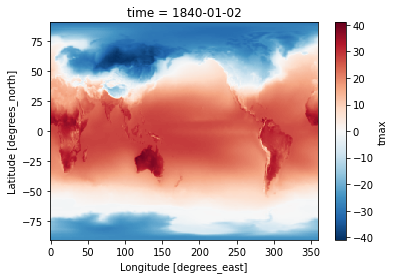

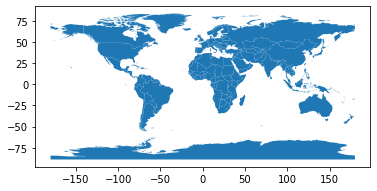

In [76]:

#Lets import the 20CR data for 1940 for now




CR20_data = xr.open_mfdataset(r"E:\LIBRARY\UNIVERSITY\Masters Research\20CR\1840_Mean_Temp.nc",decode_times=True,engine='netcdf4')
#Get it to deg C
CR20_data['tmax'] = CR20_data['tmax']-273.15

#Plot the data
CR20_data['tmax'].isel(time = 1).plot()

#Print the shape of the world
world_shape =  gpd.read_file(r"E:\LIBRARY\UNIVERSITY\Masters Research\20CR\World_Countries__Generalized_.shp")

#Plot the shape of the world
world_shape.plot()
CR20_data

In [77]:
# Create a figure and set the projection to PlateCarree
fig = plt.figure(figsize=(400, 400))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())


# Plot the NetCDF data with the boundary
CR20_data['tmax'].isel(time = 1).plot(ax=ax)

#world_shape.boundary.plot(ax=ax, color="black")



# Add map features
ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.add_feature(cfeature.LAKES, alpha=0.5)
ax.add_feature(cfeature.RIVERS)

# Define the lat/lon range for the Perth grid box
lat_min, lat_max = -32.5, -31.5
lon_min, lon_max = 115.5, 116.5

# Add 1-degree ticks for both latitude and longitude
#ax.set_xticks(np.arange(lon_min, lon_max+1, 1), crs=ccrs.PlateCarree())
#ax.set_yticks(np.arange(lat_min, lat_max+1, 1), crs=ccrs.PlateCarree())



## Add the gridlines
gl = ax.gridlines(color='b', draw_labels=True)
gl.xlocator = plt.FixedLocator(np.arange(lon_min-360, lon_max+360, 1))
gl.ylocator = plt.FixedLocator(np.arange(lat_min-180, lat_max+180, 1))
gl.xlines = True
gl.ylines = True
gl.xlabel_style = {'size': 12}
gl.ylabel_style = {'size': 12}
gl.linewidth = 2
gl.zorder = 3
# Show only left and bottom labels
gl.xlabels_bottom = True
gl.ylabels_left = True
gl.xlabels_top = False
gl.ylabels_right = False

# Add a marker for Perth airport
perth_airport = [115.974, -31.940]
ax.plot(perth_airport[0], perth_airport[1], marker='o', color='yellow', markersize=10, alpha=0.7,label = 'Perth Airport')
# Add Perth legend
#perth_legend = ax.legend(handles=[115.974, -31.940], labels=['Perth Airport'], loc='lower right', frameon=True, fontsize=12)
#perth_legend.get_frame().set_facecolor('white')
#perth_legend.get_frame().set_edgecolor('black')

# Set the extent to a region of interest
ax.set_extent([-180, 180, -90,90])
plt.legend()
# Show the plot
plt.show()

C:\Users\jarra\anaconda3\envs\shape-env\lib\site-packages\cartopy\mpl\gridliner.py:319: UserWarning: The .xlabels_bottom attribute is deprecated. Please use .bottom_labels to toggle visibility instead.
  warnings.warn('The .xlabels_bottom attribute is deprecated. Please '
C:\Users\jarra\anaconda3\envs\shape-env\lib\site-packages\cartopy\mpl\gridliner.py:331: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
C:\Users\jarra\anaconda3\envs\shape-env\lib\site-packages\cartopy\mpl\gridliner.py:307: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
C:\Users\jarra\anaconda3\envs\shape-env\lib\site-packages\cartopy\mpl\gridliner.py:343: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility inste

In [80]:

#Lets import the 20CR data for 1940 for now





CR20_data_shift_down_left = CR20_data.copy()
CR20_data_shift_down_left['lat'] = CR20_data_shift_down_left['lat']-0.5
CR20_data_shift_down_left['lon'] = CR20_data_shift_down_left['lon']-0.5


CR20_data_shift_up_right = CR20_data.copy()
CR20_data_shift_up_right['lat'] = CR20_data_shift_up_right['lat']+0.5
CR20_data_shift_up_right['lon'] = CR20_data_shift_up_right['lon']+0.5

CR20_data_shift_down_left

<xarray.Dataset>
Dimensions:    (lat: 181, lon: 360, time: 366, nbnds: 2)
Coordinates:
  * lat        (lat) float32 -90.5 -89.5 -88.5 -87.5 ... 86.5 87.5 88.5 89.5
  * lon        (lon) float32 -0.5 0.5 1.5 2.5 3.5 ... 355.5 356.5 357.5 358.5
  * time       (time) datetime64[ns] 1840-01-01 1840-01-02 ... 1840-12-31
Dimensions without coordinates: nbnds
Data variables:
    tmax       (time, lat, lon) float32 dask.array<chunksize=(366, 181, 360), meta=np.ndarray>
    time_bnds  (time, nbnds) float64 dask.array<chunksize=(366, 2), meta=np.ndarray>
Attributes: (12/24)
    Conventions:               CF-1.2
    title:                     Daily NOAA/CIRES/DOE 20th Century Reanalysis V3
    comments:                  Data are from \nNOAA/CIRES/DOE 20th Century Re...
    standard_name_vocabulary:  NetCDF Climate and Forecast (CF) Metadata Conv...
    license:                   These data are available free of charge under ...
    spatial_resolution:        1.0 degree
    ...                        ...
    citation1:                 Slivinski, L. C, G. P. Compo, J. S. Whitaker, ...
    References:                https://www.psl.noaa.gov/data/gridded/data.20t...
    creator_name:              NOAA/PSL
    institution:               NOAA Physical Sciences Laboratory & CU/CIRES \...
    contact:                   psl.data@noaa.gov
    citation:                  Compo,G.P. <https://www.psl.noaa.gov/people/gi...

In [81]:
CR20_data_shift_up_right

<xarray.Dataset>
Dimensions:    (lat: 181, lon: 360, time: 366, nbnds: 2)
Coordinates:
  * lat        (lat) float32 -89.5 -88.5 -87.5 -86.5 ... 87.5 88.5 89.5 90.5
  * lon        (lon) float32 0.5 1.5 2.5 3.5 4.5 ... 356.5 357.5 358.5 359.5
  * time       (time) datetime64[ns] 1840-01-01 1840-01-02 ... 1840-12-31
Dimensions without coordinates: nbnds
Data variables:
    tmax       (time, lat, lon) float32 dask.array<chunksize=(366, 181, 360), meta=np.ndarray>
    time_bnds  (time, nbnds) float64 dask.array<chunksize=(366, 2), meta=np.ndarray>
Attributes: (12/24)
    Conventions:               CF-1.2
    title:                     Daily NOAA/CIRES/DOE 20th Century Reanalysis V3
    comments:                  Data are from \nNOAA/CIRES/DOE 20th Century Re...
    standard_name_vocabulary:  NetCDF Climate and Forecast (CF) Metadata Conv...
    license:                   These data are available free of charge under ...
    spatial_resolution:        1.0 degree
    ...                        ...
    citation1:                 Slivinski, L. C, G. P. Compo, J. S. Whitaker, ...
    References:                https://www.psl.noaa.gov/data/gridded/data.20t...
    creator_name:              NOAA/PSL
    institution:               NOAA Physical Sciences Laboratory & CU/CIRES \...
    contact:                   psl.data@noaa.gov
    citation:                  Compo,G.P. <https://www.psl.noaa.gov/people/gi...

# DOWN LEFT

In [82]:
# Create a figure and set the projection to PlateCarree
fig = plt.figure(figsize=(400, 400))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())


# Plot the NetCDF data with the boundary
CR20_data_shift_down_left['tmax'].isel(time = 1).plot(ax=ax)

#world_shape.boundary.plot(ax=ax, color="black")



# Add map features
ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.add_feature(cfeature.LAKES, alpha=0.5)
ax.add_feature(cfeature.RIVERS)

# Define the lat/lon range for the Perth grid box
lat_min, lat_max = -32, -31
lon_min, lon_max = 115, 116

# Add 1-degree ticks for both latitude and longitude
#ax.set_xticks(np.arange(lon_min, lon_max+1, 1), crs=ccrs.PlateCarree())
#ax.set_yticks(np.arange(lat_min, lat_max+1, 1), crs=ccrs.PlateCarree())



## Add the gridlines
gl = ax.gridlines(color='b', draw_labels=True)
gl.xlocator = plt.FixedLocator(np.arange(lon_min-360, lon_max+360, 1))
gl.ylocator = plt.FixedLocator(np.arange(lat_min-180, lat_max+180, 1))
gl.xlines = True
gl.ylines = True
gl.xlabel_style = {'size': 12}
gl.ylabel_style = {'size': 12}
gl.linewidth = 2
gl.zorder = 3
# Show only left and bottom labels
gl.xlabels_bottom = True
gl.ylabels_left = True
gl.xlabels_top = False
gl.ylabels_right = False

# Add a marker for Perth airport
perth_airport = [115.974, -31.940]
ax.plot(perth_airport[0], perth_airport[1], marker='o', color='yellow', markersize=10, alpha=0.7,label = 'Perth Airport')
# Add Perth legend
#perth_legend = ax.legend(handles=[115.974, -31.940], labels=['Perth Airport'], loc='lower right', frameon=True, fontsize=12)
#perth_legend.get_frame().set_facecolor('white')
#perth_legend.get_frame().set_edgecolor('black')

# Set the extent to a region of interest
ax.set_extent([-180, 180, -90,90])
plt.legend()
# Show the plot
plt.show()

# UP RIGHT

In [83]:
# Create a figure and set the projection to PlateCarree
fig = plt.figure(figsize=(400, 400))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())


# Plot the NetCDF data with the boundary
CR20_data_shift_up_right['tmax'].isel(time = 1).plot(ax=ax)

#world_shape.boundary.plot(ax=ax, color="black")



# Add map features
ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.add_feature(cfeature.LAKES, alpha=0.5)
ax.add_feature(cfeature.RIVERS)

# Define the lat/lon range for the Perth grid box
lat_min, lat_max = -32, -31
lon_min, lon_max = 115, 116

# Add 1-degree ticks for both latitude and longitude
#ax.set_xticks(np.arange(lon_min, lon_max+1, 1), crs=ccrs.PlateCarree())
#ax.set_yticks(np.arange(lat_min, lat_max+1, 1), crs=ccrs.PlateCarree())



## Add the gridlines
gl = ax.gridlines(color='b', draw_labels=True)
gl.xlocator = plt.FixedLocator(np.arange(lon_min-360, lon_max+360, 1))
gl.ylocator = plt.FixedLocator(np.arange(lat_min-180, lat_max+180, 1))
gl.xlines = True
gl.ylines = True
gl.xlabel_style = {'size': 12}
gl.ylabel_style = {'size': 12}
gl.linewidth = 2
gl.zorder = 3
# Show only left and bottom labels
gl.xlabels_bottom = True
gl.ylabels_left = True
gl.xlabels_top = False
gl.ylabels_right = False

# Add a marker for Perth airport
perth_airport = [115.974, -31.940]
ax.plot(perth_airport[0], perth_airport[1], marker='o', color='yellow', markersize=10, alpha=0.7,label = 'Perth Airport')
# Add Perth legend
#perth_legend = ax.legend(handles=[115.974, -31.940], labels=['Perth Airport'], loc='lower right', frameon=True, fontsize=12)
#perth_legend.get_frame().set_facecolor('white')
#perth_legend.get_frame().set_edgecolor('black')

# Set the extent to a region of interest
ax.set_extent([-180, 180, -90,90])
plt.legend()
# Show the plot
plt.show()

In [48]:
CR20_data_shift_up_right['lat'] = CR20_data_shift_up_right['lat']+0.5
CR20_data_shift_up_right

<xarray.Dataset>
Dimensions:    (lat: 181, lon: 360, time: 366, nbnds: 2)
Coordinates:
  * lat        (lat) float32 -88.5 -87.5 -86.5 -85.5 ... 88.5 89.5 90.5 91.5
  * lon        (lon) float32 0.0 1.0 2.0 3.0 4.0 ... 356.0 357.0 358.0 359.0
  * time       (time) datetime64[ns] 1840-01-01 1840-01-02 ... 1840-12-31
Dimensions without coordinates: nbnds
Data variables:
    tmax       (time, lat, lon) float32 dask.array<chunksize=(366, 181, 360), meta=np.ndarray>
    time_bnds  (time, nbnds) float64 dask.array<chunksize=(366, 2), meta=np.ndarray>
Attributes: (12/24)
    Conventions:               CF-1.2
    title:                     Daily NOAA/CIRES/DOE 20th Century Reanalysis V3
    comments:                  Data are from \nNOAA/CIRES/DOE 20th Century Re...
    standard_name_vocabulary:  NetCDF Climate and Forecast (CF) Metadata Conv...
    license:                   These data are available free of charge under ...
    spatial_resolution:        1.0 degree
    ...                        ...
    citation1:                 Slivinski, L. C, G. P. Compo, J. S. Whitaker, ...
    References:                https://www.psl.noaa.gov/data/gridded/data.20t...
    creator_name:              NOAA/PSL
    institution:               NOAA Physical Sciences Laboratory & CU/CIRES \...
    contact:                   psl.data@noaa.gov
    citation:                  Compo,G.P. <https://www.psl.noaa.gov/people/gi...